# Starbucks Capstone Project

## Project Overview

Once every few days, Starbucks sends out an offer to users of the Starbucks rewards mobile app. An offer can be merely an advertisement for a drink or an actual offer such as a discount or BOGO (buy one get one free). However, customers do not opt into the offers that they receive; in other words, a user can receive an offer, never actually view the offer, and still complete the offer. Therefore, there will be an offer completion record in the data set; however, the customer was not influenced by the offer because the customer never viewed the offer. This data set contains simulated data that mimics customer behavior on the Starbucks rewards mobile app.

## Problem Statement

Using the datasets our objective is combining these datasets after cleansing and use this information to determine the best offer reward for each demographic group and deterimne users that does not need an offer to make a purchase so using CRISP-DM we can state multiple statments that can help with the requirments which needed to be studied

* Characteristics of users that view offers and there persentage.
* The contribution of advertisement in user transactions
* Responding to an offer percentage & completion of offers percentage
* Predicting whether the user will respond to an offer according to his demographic group.

## Metrics

The F1 score is chosen to be the metric as it defines the harmonic mean of precision and recall.

<img src="f1score.png" width="350"/>


## Data Sets

The data is contained in three files:

**portfolio.json**
* id (string) - offer id
* offer_type (string) - type of offer ie BOGO, discount, informational
* difficulty (int) - minimum required spend to complete an offer
* reward (int) - reward given for completing an offer
* duration (int) - time for offer to be open, in days
* channels (list of strings)

**profile.json**
* age (int) - age of the customer 
* became_member_on (int) - date when customer created an app account
* gender (str) - gender of the customer (note some entries contain 'O' for other rather than M or F)
* id (str) - customer id
* income (float) - customer's income

**transcript.json**
* event (str) - record description (ie transaction, offer received, offer viewed, etc.)
* person (str) - customer id
* time (int) - time in hours since start of test. The data begins at time t=0
* value - (dict of strings) - either an offer id or transaction amount depending on the record


## Data Understanding

#### Import Statements

In [1]:
import pandas as pd
import numpy as np
import math
import json
import matplotlib.pyplot as plt
import seaborn as sns
import re

from sklearn.model_selection import GridSearchCV
from sklearn.svm import LinearSVC
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.metrics import classification_report
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

%matplotlib inline

# read in the json files
portfolio = pd.read_json('data/portfolio.json', orient='records', lines=True)
profile = pd.read_json('data/profile.json', orient='records', lines=True)
transcript = pd.read_json('data/transcript.json', orient='records', lines=True)

pd.options.mode.chained_assignment = None



A quick look into our data:

In [2]:
print('portfolio',portfolio.shape)
print('profile',profile.shape)
print('transcript',transcript.shape)

portfolio (10, 6)
profile (17000, 5)
transcript (306534, 4)


In [3]:
portfolio

,reward,channels,difficulty,duration,offer_type,id
0,10,"[email, mobile, social]",10,7,bogo,ae264e3637204a6fb9bb56bc8210ddfd
1,10,"[web, email, mobile, social]",10,5,bogo,4d5c57ea9a6940dd891ad53e9dbe8da0
2,0,"[web, email, mobile]",0,4,informational,3f207df678b143eea3cee63160fa8bed
3,5,"[web, email, mobile]",5,7,bogo,9b98b8c7a33c4b65b9aebfe6a799e6d9
4,5,"[web, email]",20,10,discount,0b1e1539f2cc45b7b9fa7c272da2e1d7
5,3,"[web, email, mobile, social]",7,7,discount,2298d6c36e964ae4a3e7e9706d1fb8c2
6,2,"[web, email, mobile, social]",10,10,discount,fafdcd668e3743c1bb461111dcafc2a4
7,0,"[email, mobile, social]",0,3,informational,5a8bc65990b245e5a138643cd4eb9837
8,5,"[web, email, mobile, social]",5,5,bogo,f19421c1d4aa40978ebb69ca19b0e20d
9,2,"[web, email, mobile]",10,7,discount,2906b810c7d4411798c6938adc9daaa5


In [4]:
profile.head()

,gender,age,id,became_member_on,income
0,None,118,68be06ca386d4c31939f3a4f0e3dd783,20170212,NaN
1,F,55,0610b486422d4921ae7d2bf64640c50b,20170715,112000.0
2,None,118,38fe809add3b4fcf9315a9694bb96ff5,20180712,NaN
3,F,75,78afa995795e4d85b5d9ceeca43f5fef,20170509,100000.0
4,None,118,a03223e636434f42ac4c3df47e8bac43,20170804,NaN


In [5]:
transcript.head()

,person,event,value,time
0,78afa995795e4d85b5d9ceeca43f5fef,offer received,{'offer id': '9b98b8c7a33c4b65b9aebfe6a799e6d9'},0
1,a03223e636434f42ac4c3df47e8bac43,offer received,{'offer id': '0b1e1539f2cc45b7b9fa7c272da2e1d7'},0
2,e2127556f4f64592b11af22de27a7932,offer received,{'offer id': '2906b810c7d4411798c6938adc9daaa5'},0
3,8ec6ce2a7e7949b1bf142def7d0e0586,offer received,{'offer id': 'fafdcd668e3743c1bb461111dcafc2a4'},0
4,68617ca6246f4fbc85e91a2a49552598,offer received,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},0


# Data Preparation

Data wrangling on each dataset so ot can be useable

**Portofolio**

Converting channels and offer types to dummy variables preparing it for modeling.

In [6]:
# offer type dummies
offer_dummies = pd.get_dummies(portfolio['offer_type'],prefix='type')

# Channels column dummies
channel_dummies = portfolio['channels'].apply(lambda x: str(x)[1:-1].replace('\'','')).str.get_dummies(sep = ', ')
# Remove white spaces from columns
channel_dummies.columns = channel_dummies.columns.str.strip()



# Concatinate new columns to portofolio and remove channels and offer_type columns
portfolio = pd.concat([portfolio,offer_dummies,channel_dummies],axis=1).drop(['channels'],axis=1)

portfolio

,reward,difficulty,duration,offer_type,id,type_bogo,type_discount,type_informational,email,mobile,social,web
0,10,10,7,bogo,ae264e3637204a6fb9bb56bc8210ddfd,1,0,0,1,1,1,0
1,10,10,5,bogo,4d5c57ea9a6940dd891ad53e9dbe8da0,1,0,0,1,1,1,1
2,0,0,4,informational,3f207df678b143eea3cee63160fa8bed,0,0,1,1,1,0,1
3,5,5,7,bogo,9b98b8c7a33c4b65b9aebfe6a799e6d9,1,0,0,1,1,0,1
4,5,20,10,discount,0b1e1539f2cc45b7b9fa7c272da2e1d7,0,1,0,1,0,0,1
5,3,7,7,discount,2298d6c36e964ae4a3e7e9706d1fb8c2,0,1,0,1,1,1,1
6,2,10,10,discount,fafdcd668e3743c1bb461111dcafc2a4,0,1,0,1,1,1,1
7,0,0,3,informational,5a8bc65990b245e5a138643cd4eb9837,0,0,1,1,1,1,0
8,5,5,5,bogo,f19421c1d4aa40978ebb69ca19b0e20d,1,0,0,1,1,1,1
9,2,10,7,discount,2906b810c7d4411798c6938adc9daaa5,0,1,0,1,1,0,1


**Profile**
Formating profile columns 


In [7]:
# format 'became_member_of' column to timestamp
profile['became_member_on'] = pd.to_datetime(profile['became_member_on'],format='%Y%m%d')

# Classify gender into M, F, and O, so gender with None values will be replaced by 'O'
profile['gender'] = profile['gender'].apply(lambda x: 'O' if x is None else x)

# gender dummies
gender_dummies = pd.get_dummies(profile['gender'],prefix='gender')

# Concatinate new columns to profile and remove gender column
profile = pd.concat([profile,gender_dummies],axis = 1)

In [8]:
profile.head()

,gender,age,id,became_member_on,income,gender_F,gender_M,gender_O
0,O,118,68be06ca386d4c31939f3a4f0e3dd783,2017-02-12,NaN,0,0,1
1,F,55,0610b486422d4921ae7d2bf64640c50b,2017-07-15,112000.0,1,0,0
2,O,118,38fe809add3b4fcf9315a9694bb96ff5,2018-07-12,NaN,0,0,1
3,F,75,78afa995795e4d85b5d9ceeca43f5fef,2017-05-09,100000.0,1,0,0
4,O,118,a03223e636434f42ac4c3df47e8bac43,2017-08-04,NaN,0,0,1


**Transcript**

Data wrangling of transcript data set finding event dummies and generating offer_id column to facilitate the merging of tables
adding reward column if reward given on a transaction and its amount

In [9]:
# Generate dummy columns for 'event colum'
dummy_event = pd.get_dummies(transcript['event'])

# Concatinate new columns to transcript
transcript = pd.concat([transcript,dummy_event],axis = 1)

# Generate offer_id column to hold the offer id of the value column if any, otherwise it will have a nan
transcript['offer_id'] = transcript.value.apply(lambda x: x['offer id'] if 'offer id' in x else\
                                                x['offer_id'] if 'offer_id' in x else np.nan)

# Generate reward_value column to hold the reward value of the value column if any, otherwise it will have a zero
transcript['reward_given'] = transcript.value.apply(lambda x: x['reward'] if 'reward' in x else 0)

# Generate amount column to hold the transaction amount of the value column if any, otherwise it will have a zero
transcript['amount'] = transcript.value.apply(lambda x: x['amount'] if 'amount' in x else 0)


# # Remove value and event columns
transcript.drop(['value','event'],axis=1,inplace=True)

# Remove duplicated rows
transcript.drop_duplicates(inplace=True,ignore_index=True)

transcript.head()

,person,time,offer completed,offer received,offer viewed,transaction,offer_id,reward_given,amount
0,78afa995795e4d85b5d9ceeca43f5fef,0,0,1,0,0,9b98b8c7a33c4b65b9aebfe6a799e6d9,0,0.0
1,a03223e636434f42ac4c3df47e8bac43,0,0,1,0,0,0b1e1539f2cc45b7b9fa7c272da2e1d7,0,0.0
2,e2127556f4f64592b11af22de27a7932,0,0,1,0,0,2906b810c7d4411798c6938adc9daaa5,0,0.0
3,8ec6ce2a7e7949b1bf142def7d0e0586,0,0,1,0,0,fafdcd668e3743c1bb461111dcafc2a4,0,0.0
4,68617ca6246f4fbc85e91a2a49552598,0,0,1,0,0,4d5c57ea9a6940dd891ad53e9dbe8da0,0,0.0


## Data Exploration

Gaining insights about the dataset so we can filter unneeded information and deduce a methodology to find patterns and the datasets which contain explorable data are the profiles and transcripts where portoflio dataset is more of an refrence table.

Starting with the profiles table we need to have an insight about customers age and gender

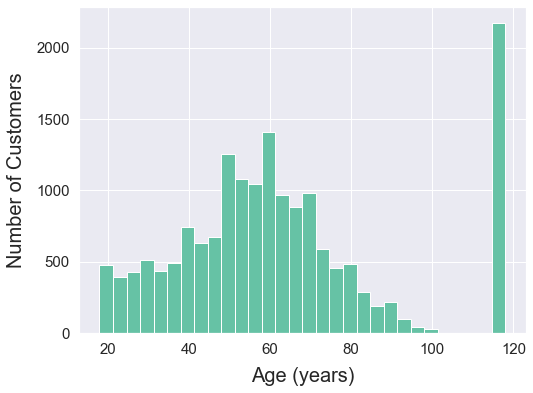

In [10]:
sns.set()
base_color = sns.color_palette("Set2")

plt.figure(figsize = [8,6])
plt.hist(profile['age'], bins = 30,color=base_color[0]);
plt.xlabel('Age (years)',fontsize=20,labelpad=10)
plt.ylabel('Number of Customers',fontsize=20,labelpad=10);
plt.xticks(fontsize=15);
plt.yticks(fontsize=15);

There is something strange about this graph where number of customers at 118 age is not expectable so we need to find a relation between these customers

In [11]:
profile[profile['age']==118].head()

,gender,age,id,became_member_on,income,gender_F,gender_M,gender_O
0,O,118,68be06ca386d4c31939f3a4f0e3dd783,2017-02-12,NaN,0,0,1
2,O,118,38fe809add3b4fcf9315a9694bb96ff5,2018-07-12,NaN,0,0,1
4,O,118,a03223e636434f42ac4c3df47e8bac43,2017-08-04,NaN,0,0,1
6,O,118,8ec6ce2a7e7949b1bf142def7d0e0586,2017-09-25,NaN,0,0,1
7,O,118,68617ca6246f4fbc85e91a2a49552598,2017-10-02,NaN,0,0,1


From the initial look we can assume that all users with 118 age have gender and income missing information so go in depth to prove this statment

In [12]:
profile[profile['age']==118].shape[0]

2175

In [13]:
profile[profile['income'].isnull()].shape[0]

2175

In [14]:
profile[(profile['age']==118) & (profile['income'].isnull()) & (profile['gender_O'] ==1)].shape[0]

2175

Proving that these are the groups prefer to not share there personal information, benifiting from this data by classifing them as anonymus. we therefore create a new column to identify them and see their distribution in the dataset.

In [15]:
profile['anonymous'] = profile.apply(lambda x: 1 if x['age']==118 else 0,axis=1)

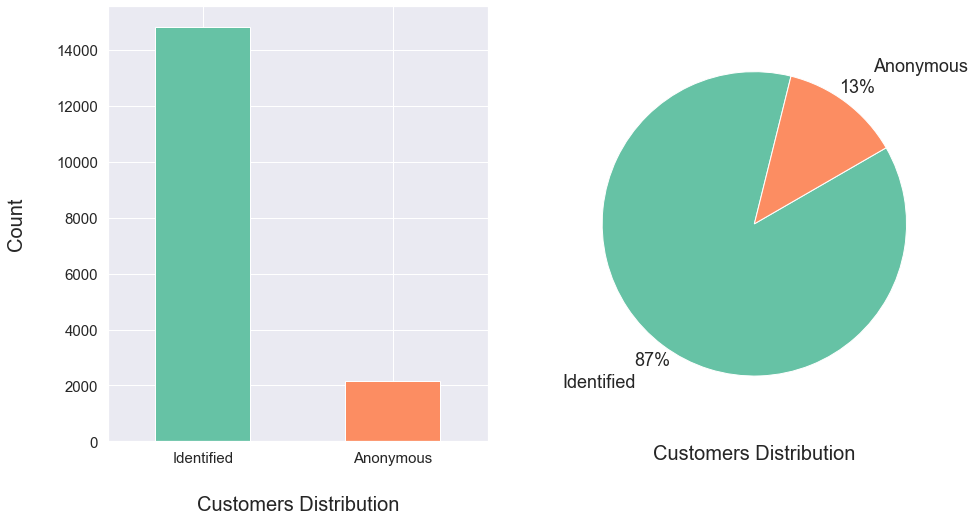

In [16]:
anon_dist = profile['anonymous'].value_counts()

plt.figure(figsize = [15,8])


# Bar chart
plt.subplot(1,2,1)
anon_dist.plot(kind='bar',color=base_color)

plt.xticks(ticks = [0,1], labels = ['Identified','Anonymous'],rotation = 0,fontsize=15)
plt.yticks(fontsize=15)
plt.ylabel('Count',fontsize=20,labelpad=30,rotation = 90)
plt.xlabel('Customers Distribution',fontsize=20,labelpad=30)

# Pie chart
plt.subplot(1,2,2)
anon_dist.plot(kind='pie',colors=base_color,startangle = 30,counterclock=False,autopct='%1.0f%%',labels=['Identified','Anonymous'],\
               textprops={'fontsize': 18},pctdistance=1.12,labeldistance=1.3)
plt.ylabel('');
plt.xlabel('Customers Distribution',fontsize=20,labelpad=30);


Excluding unwanted data of the anonymous group

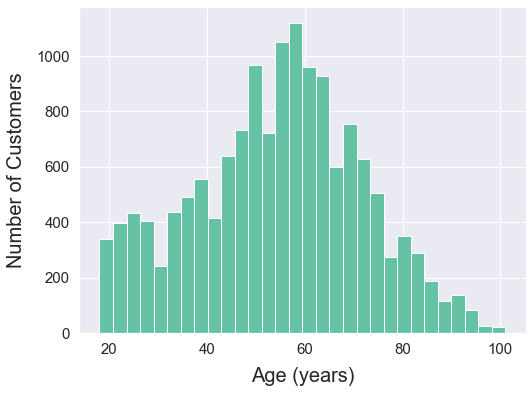

In [17]:
age_dist = profile[profile['anonymous']==0]['age']
plt.figure(figsize = [8,6])
plt.hist(age_dist, bins = 30,color=base_color[0]);
plt.xlabel('Age (years)',fontsize=20,labelpad=10)
plt.ylabel('Number of Customers',fontsize=20,labelpad=10);
plt.xticks(fontsize=15);
plt.yticks(fontsize=15);

Majority of the customers are in the range of late 50's , early 60's and it deviate away from the mean age.
Removing the anonymus group again to investigate the gender data.

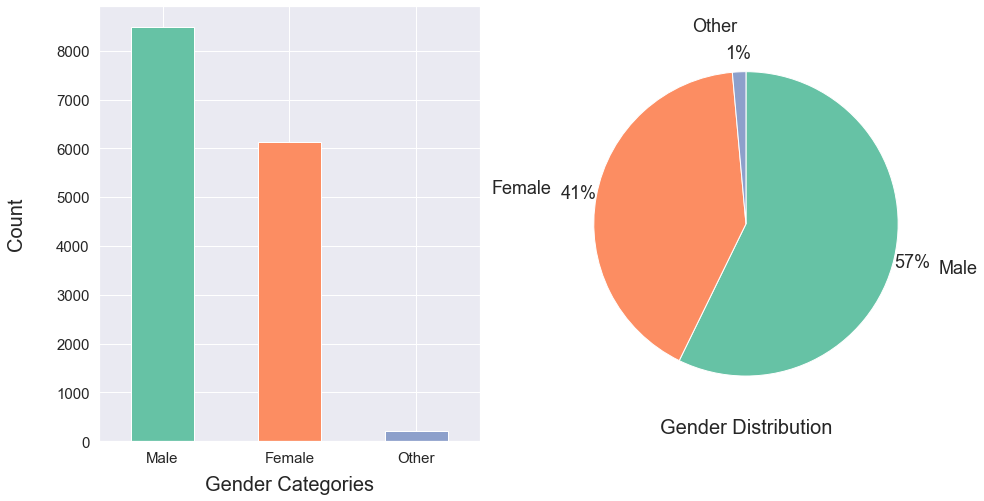

In [18]:
# Filter Gender Categories by removing anonymous customers
gend_dist = profile[profile['anonymous']==0][['gender_M','gender_F','gender_O']].sum()

# Plotting
plt.figure(figsize = [15,8])

# Bar chart
plt.subplot(1,2,1)
gend_dist.plot(kind='bar',color=base_color)

plt.xticks(ticks = [0,1,2], labels = ['Male','Female','Other'],rotation = 0,fontsize=15)
plt.yticks(fontsize=15)
plt.xlabel('Gender Categories',fontsize=20,labelpad=10)
plt.ylabel('Count',fontsize=20,labelpad=30,rotation = 90)

# Pie chart
plt.subplot(1,2,2)
gend_dist.plot(kind='pie',colors=base_color,startangle = 90,counterclock=False,autopct='%1.0f%%',\
               labels=['Male','Female','Other'],\
               textprops={'fontsize': 18},pctdistance=1.12,labeldistance=1.3)
plt.ylabel('')
plt.xlabel('Gender Distribution',fontsize=20);

With a 16% diffrence most customers are males then females and small percentage are classified as other

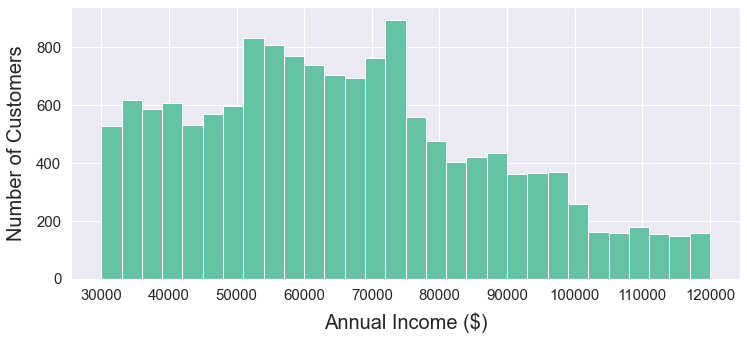

In [19]:
inc_dist = profile[profile['anonymous']==0]['income']
plt.figure(figsize = [12,5])
plt.hist(inc_dist, bins = 30,color=base_color[0]);
plt.xlabel('Annual Income ($)',fontsize=20,labelpad=10)
plt.ylabel('Number of Customers',fontsize=20,labelpad=10);
plt.xticks(range(30000,130000,10000),fontsize=15);
plt.yticks(fontsize=15);

Most of the customers annual income are bellow 80000\\$ where the majority are in the range between 50000\\$ and 75000\\$ and fewer users as the income increase.

Exploring the transcript data to view and categorize events

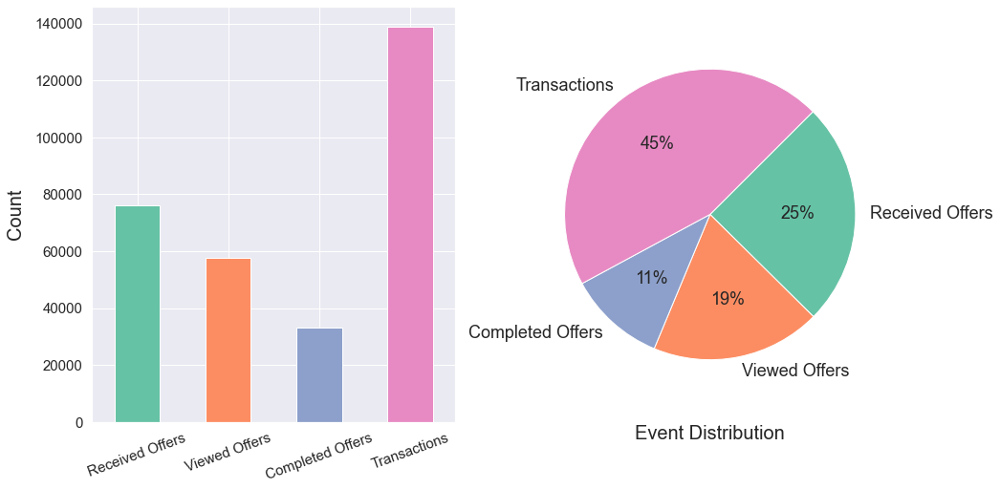

In [20]:
event_dist = transcript[['offer received','offer viewed','offer completed','transaction']].sum()

# Plotting
plt.figure(figsize = [15,8])

# Bar chart
plt.subplot(1,2,1)
event_dist.plot(kind='bar',color=base_color)
plt.xticks(ticks=[0,1,2,3],labels=['Received Offers','Viewed Offers','Completed Offers','Transactions'],rotation = 20,\
          fontsize=15);
plt.ylabel('Count',fontsize=20,labelpad=10,rotation = 90)
plt.yticks(fontsize=15);

# Pie chart
plt.subplot(1,2,2)
event_dist.plot(kind='pie',colors=base_color,startangle = 45,counterclock=False,autopct='%1.0f%%',\
                labels=['Received Offers','Viewed Offers','Completed Offers','Transactions'],\
                textprops={'fontsize': 18})
plt.ylabel('')
plt.xlabel('Event Distribution',fontsize=20,labelpad=30);


The dataset contains 2 event types:
* **Offer** - which is classified according to action:
    * Received Offers
    * Viewed Offers
    * Completed Offers
    
* **Transaction** - which have transaction history

The offers make up to 55% of the dataset leaving 45% for transactions.

We can see the percentage of viewed offers from all sent ones.

In [21]:
transcript[transcript['offer viewed']==1].shape[0]/transcript[transcript['offer received']==1].shape[0]*100

75.67812053436815

Also the completed offers from all viewed offers

In [22]:
transcript[transcript['offer completed']==1].shape[0]/transcript[transcript['offer viewed']==1].shape[0]*100

57.48289302728454

We then need to combine these datasets and we will rename some columns for easier manipulation

In [23]:
portfolio.rename(columns={"id":"offer_id","reward":"offer_reward"},inplace=True)
transcript.rename(columns={"person":"user_id","offer viewed":"offer_viewed",\
                           "offer received":"offer_received",\
                          "offer completed":"offer_completed"},inplace=True)
profile.rename(columns={"id":"user_id"},inplace=True)

Now we are ready to merge the dataframes.

In [24]:
pd.set_option('display.max_columns', None)
df = pd.merge(pd.merge(transcript, portfolio, on='offer_id',how='left'), profile, on='user_id')

If we compare the reward_given and the offer_reward columns we can find that they're identicle whenever there is an offer completed event. So we can drop the reward_given column.

In [25]:
(df[df['reward_given']>0]['reward_given'] - df[df['reward_given']>0]['offer_reward']).sum()

0.0

In [26]:
df.drop(['reward_given'],axis =1,inplace=True)

Lets view sent offers distribution

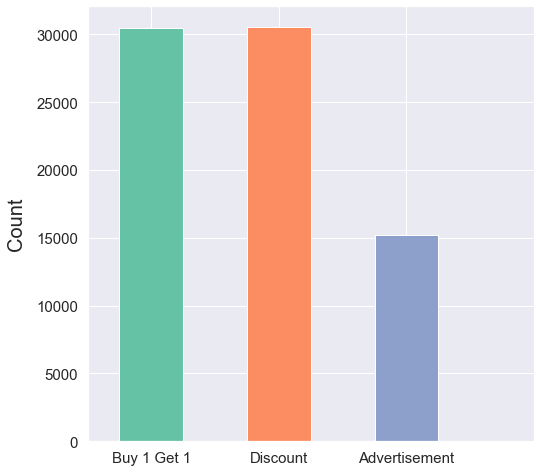

In [27]:
offer_types_dist = df[df['offer_received']==1][['type_bogo','type_discount','type_informational']].sum()

# Plotting
plt.figure(figsize = [8,8])

# Bar chart
offer_types_dist.plot(kind='bar',color=base_color)
plt.xticks(ticks=[0,1,2,3],labels=['Buy 1 Get 1','Discount','Advertisement'],rotation = 0,fontsize=15);
plt.ylabel('Count',fontsize=20,labelpad=10,rotation = 90)
plt.yticks(fontsize=15);

Number of **BOGO** and **Discount** offers sent are the same, where the number of **Advertisement** offers sent is about the half.

We need to select records transactions records after recieving rthe offer while it is valid.
Doing that by classifing the dataframe into 3 groups according to the event, then using the **offer_expiration** column.

In [28]:
# Dataframe holding the events where an offer was received
offer_received_df = df[df['offer_received'] == 1][['offer_id','user_id','time','duration']]\
.rename(columns={"time":"time_received"})

# Dataframe holding the events where an offer was viewed
offer_viewed_df = df[df['offer_viewed'] == 1][['offer_id','user_id','time']]

# Dataframe holding the events where an offer was completed
offer_completed_df = df[df['offer_completed'] == 1][['offer_id','user_id','time']]

Now we merge those dataframes on the **user_id** and **offer_id** columns, to be able to compare the time between transactions.

In [29]:
# merge completed and viewd dataframes
offers_df = pd.merge(offer_completed_df,offer_viewed_df, on=['offer_id','user_id'],\
                     suffixes=('_completed','_viewed'))

# merge them with received dataframe
offers_df = pd.merge(offers_df,offer_received_df, on=['offer_id','user_id'])

Calculating the deadline of each offer

In [30]:
offers_df['offer_deadline'] = offers_df.apply(lambda x: x['time_received']+int(x['duration'])*24,axis =1)

In [31]:
df[(df['offer_completed']==1)].groupby(['offer_id','user_id','time']).size().max()

1

And same for the offer received.

In [32]:
df[(df['offer_received']==1)].groupby(['offer_id','user_id','time']).size().max()

1

These lines as a checker that a offer is not used twice.

In [33]:
# Remove duplicate rows
clean_df = offers_df.drop_duplicates(subset=['offer_id','user_id','time_completed'])
clean_df = clean_df.drop_duplicates(subset=['offer_id','user_id','time_received'])

Now we can easily see select customers who completed the offer after viewing it and before it expires.

In [34]:
clean_df = clean_df[(clean_df['time_viewed'] >= clean_df['time_received']) &\
                 (clean_df['time_completed'] <= clean_df['offer_deadline'])]
clean_df

,offer_id,user_id,time_completed,time_viewed,time_received,duration,offer_deadline
0,9b98b8c7a33c4b65b9aebfe6a799e6d9,78afa995795e4d85b5d9ceeca43f5fef,132,6,0,7.0,168
1,ae264e3637204a6fb9bb56bc8210ddfd,78afa995795e4d85b5d9ceeca43f5fef,510,408,408,7.0,576
2,f19421c1d4aa40978ebb69ca19b0e20d,78afa995795e4d85b5d9ceeca43f5fef,510,582,504,5.0,624
3,9b98b8c7a33c4b65b9aebfe6a799e6d9,e2127556f4f64592b11af22de27a7932,522,420,408,7.0,576
4,fafdcd668e3743c1bb461111dcafc2a4,e2127556f4f64592b11af22de27a7932,522,522,504,10.0,744
...,...,...,...,...,...,...,...
59943,4d5c57ea9a6940dd891ad53e9dbe8da0,3a298dbf99ef4a23b9b46a1500e56101,588,582,576,5.0,696
59944,9b98b8c7a33c4b65b9aebfe6a799e6d9,bad805c0568d49ae9bf2f046b6ea2be0,678,606,576,7.0,744
59945,f19421c1d4aa40978ebb69ca19b0e20d,fc966e9c3edc4578a1fb4c6a8c2659c2,528,516,504,5.0,624
59946,2298d6c36e964ae4a3e7e9706d1fb8c2,fc966e9c3edc4578a1fb4c6a8c2659c2,654,594,576,7.0,744


We can use this data to compare between number of customers who completed an offer after viewing and the users who completed without viewing it and combine the data with the original dataframe.

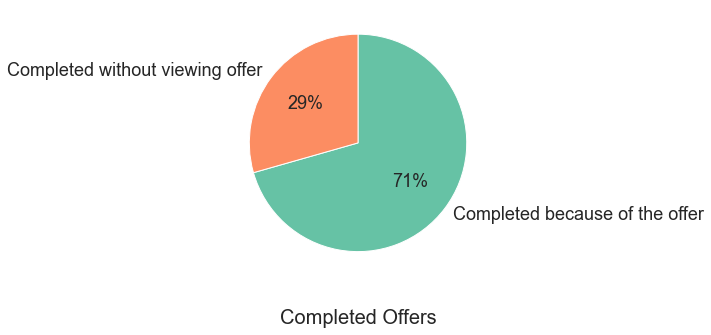

In [35]:
# mark users
clean_df['offer_success'] =1

# Merge dataframes on index
df1=df[df['offer_completed']==1].set_index(['offer_id','user_id','time'])
df2 = clean_df.rename(columns={"time_completed":"time"}).set_index(['offer_id','user_id','time'])['offer_success']
completed_offers_df = pd.merge(df1,df2,left_index=True,right_index=True,how="left")

# replace NaN values in offer_success column with 0
completed_offers_df['offer_success'] = completed_offers_df['offer_success'].fillna(0)

# Pie chart
plt.figure(figsize = [8,5])

completed_offers_df['offer_success'].value_counts().plot(kind='pie',colors=base_color,startangle = 90,counterclock=False,autopct='%1.0f%%',\
                labels=['Completed because of the offer','Completed without viewing offer'],\
                textprops={'fontsize': 18})
plt.ylabel('')
plt.xlabel('Completed Offers',fontsize=20,labelpad=30);

71% of customers completed the offers after viewing them. we can use this percentage as the reach and effect of offers 
now we want to know the reach and effect percentage of advertisment.

In [36]:
# Dataframe holding the events where an advertisement offer was received
adv_received_df = df[(df['offer_received'] == 1) & (df['type_informational'] == 1)][['offer_id','user_id','time','duration']]\
.rename(columns={"time":"time_received"})

# Dataframe holding the events where an advertisement offer was viewed
adv_viewed_df = df[(df['offer_viewed'] == 1) & (df['type_informational'] == 1)][['offer_id','user_id','time']]

# Dataframe holding the events where a transaction took place
transaction_df = df[(df['transaction'] == 1)][['user_id','time','amount']]

# merge transaction and adv_viewd dataframes
merged_df_adv = pd.merge(transaction_df,adv_viewed_df, on=['user_id'],suffixes=('_transaction','_viewed'))

# merge them with received dataframe
merged_df_adv = pd.merge(merged_df_adv,adv_received_df, on=['offer_id','user_id'])

# Calculate deadline
merged_df_adv['adv_deadline'] = merged_df_adv.apply(lambda x: x['time_received']+int(x['duration'])*24,axis =1)

In [37]:
df[(df['transaction']==1)].groupby(['user_id','time']).size().max()

1

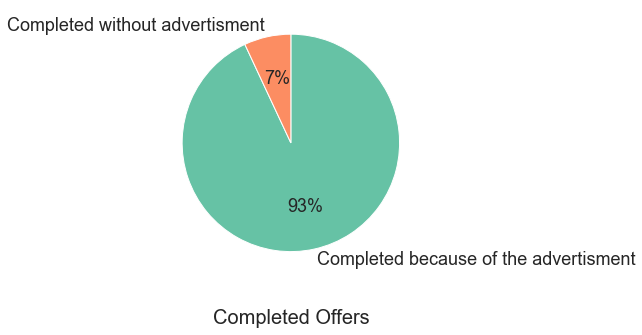

In [38]:
# Remove duplicate rows
clean_adv_df = merged_df_adv.drop_duplicates(subset=['user_id','time_transaction'])

# Filter to get transactions that happened because of an advertisement
clean_adv_df = clean_adv_df[(clean_adv_df['time_transaction'] >= clean_adv_df['time_received']) &\
                 (clean_adv_df['time_transaction'] <= clean_adv_df['adv_deadline'])]

# mark customers influenced by advertisement offer
clean_adv_df['offer_success'] =1

# Merge dataframes on index
df_adv1=df[df['transaction']==1].set_index(['user_id','time'])
df_adv2 = clean_adv_df.rename(columns={"time_transaction":"time"}).set_index(['user_id','time'])['offer_success']
adv_df = pd.merge(df_adv1,df_adv2,left_index=True,right_index=True,how="left")

# replace NaN values in offer_success column with 0
adv_df['offer_success'] = adv_df['offer_success'].fillna(0)

# Pie chart
plt.figure(figsize = [8,5])

adv_df['offer_success'].value_counts().plot(kind='pie',colors=base_color,startangle = 90,counterclock=False,autopct='%1.0f%%',\
                labels=['Completed because of the advertisment','Completed without advertisment'],\
                textprops={'fontsize': 18})
plt.ylabel('')
plt.xlabel('Completed Offers',fontsize=20,labelpad=30);


We can find that the advertisment reach is greater than offers reach

Combining both dataframes, seeing events effect on customers

In [39]:
final_df = pd.concat([completed_offers_df.reset_index(),adv_df.reset_index()])

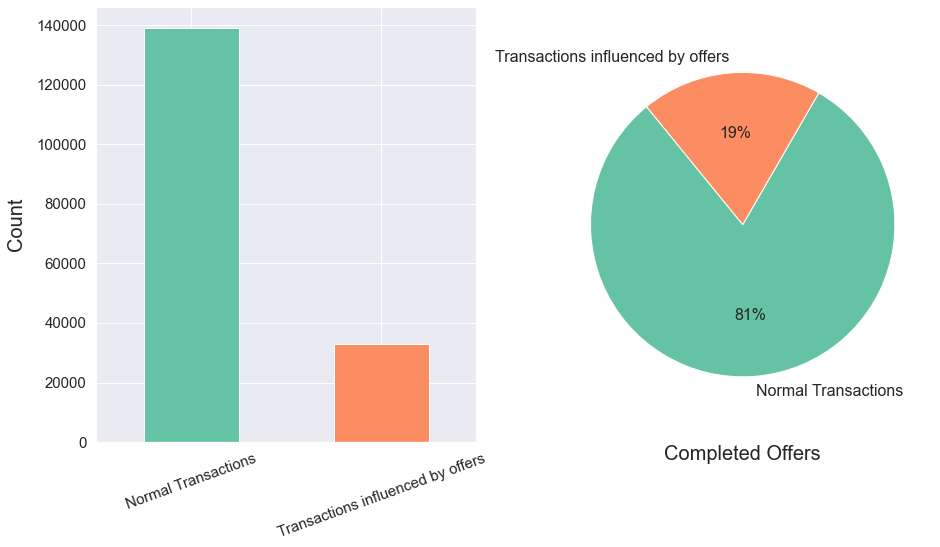

In [40]:
offer_influence = final_df['offer_success'].value_counts()
# Plotting
plt.figure(figsize = [15,8])

# Bar chart
plt.subplot(1,2,1)
offer_influence.plot(kind='bar',color=base_color)
plt.xticks(ticks=[0,1],labels=['Normal Transactions','Transactions influenced by offers'],rotation = 20,\
          fontsize=15);
plt.ylabel('Count',fontsize=20,labelpad=10,rotation = 90)
plt.yticks(fontsize=15);

# Pie chart
plt.subplot(1,2,2)

offer_influence.plot(kind='pie',colors=base_color,startangle = 60,counterclock=False,autopct='%1.0f%%',\
                labels=['Normal Transactions','Transactions influenced by offers'],\
                textprops={'fontsize': 16})
plt.ylabel('')
plt.xlabel('Completed Offers',fontsize=20,labelpad=30);

**19%**  of all transactions is the influence of offers to customers where that is a good number. so now we need to study the demographics of customers who used and was influnced by these offers.
We will begin with the gender and its relation with transactions amount also the suitable offer type for each gender

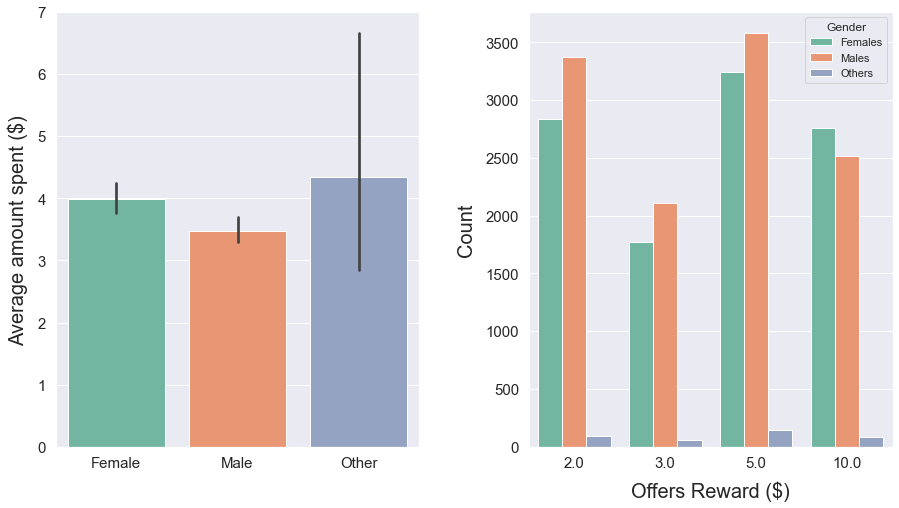

In [41]:
# Plotting
plt.figure(figsize = [15,8])
plt.subplots_adjust(wspace = 0.3)
# Box plot
plt.subplot(1,2,1)

sns.barplot(data = final_df[(final_df['anonymous']==0) &(final_df['offer_success']==1)],palette="Set2",x='gender',y='amount');
plt.xticks(ticks=[0,1,2],labels=['Female','Male','Other'],fontsize=15)
plt.ylim([0,7])
plt.xlabel('');
plt.ylabel('Average amount spent ($)',fontsize=20,labelpad=10);
plt.yticks(fontsize=15);

# Clustered Bar chart
plt.subplot(1,2,2)

sns.countplot(data=final_df[(final_df['anonymous']==0) & (final_df['offer_success']==1)],palette="Set2",x='offer_reward',hue='gender')
plt.legend(title='Gender', loc='upper right', labels=['Females', 'Males','Others']);
plt.xticks(fontsize=15);
plt.yticks(fontsize=15);

plt.xlabel('Offers Reward ($)',fontsize=20,labelpad=10);
plt.ylabel('Count',fontsize=20,labelpad=10);

Observe that on average, males spend less compared to females while **Others** category seems to be spending the most, it is probably due to their low number compared to males and females.  

The 2,3,5 dollars offer rewards seems to attract males while the 10 offer rewards is more intersting for females

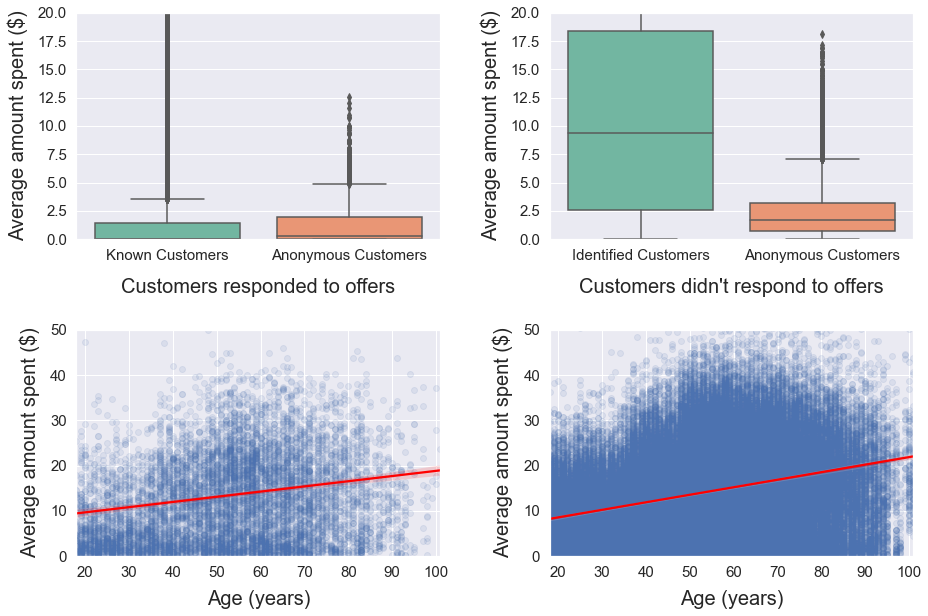

In [42]:
# Plotting
plt.figure(figsize = [15,10])
plt.subplots_adjust(wspace = 0.3)
plt.subplots_adjust(hspace = 0.4)

# Box plot
plt.subplot(2,2,1)

sns.boxplot(data = final_df[(final_df['offer_success']==1)],palette="Set2",x='anonymous',y='amount');
plt.xticks(ticks=[0,1,],labels=['Known Customers','Anonymous Customers'],fontsize=15)
plt.ylim([0,20])
plt.ylabel('Average amount spent ($)',fontsize=20,labelpad=10);
plt.yticks(fontsize=15);
plt.xlabel('Customers responded to offers',fontsize=20,labelpad=15);

# Box plot
plt.subplot(2,2,2)

sns.boxplot(data = final_df[(final_df['offer_success']==0)],palette="Set2",x='anonymous',y='amount');
plt.xticks(ticks=[0,1,],labels=['Identified Customers','Anonymous Customers'],fontsize=15)
plt.ylim([0,20])
plt.ylabel('Average amount spent ($)',fontsize=20,labelpad=10);
plt.yticks(fontsize=15);
plt.xlabel('Customers didn\'t respond to offers',fontsize=20,labelpad=15);


# Clustered Bar chart
plt.subplot(2,2,3)

sns.regplot(data = final_df[(final_df['anonymous']==0) & (final_df['transaction']==1) & (final_df['offer_success']==1)]\
            ,x='age',y='amount',scatter_kws = {'alpha':1/10},line_kws={'color': 'red'});
plt.ylim([0,50]);
plt.xticks(fontsize=15);
plt.yticks(fontsize=15);

plt.xlabel('Age (years)',fontsize=20,labelpad=10);
plt.ylabel('Average amount spent ($)',fontsize=20,labelpad=10);


# Clustered Bar chart
plt.subplot(2,2,4)

sns.regplot(data = final_df[(final_df['anonymous']==0) & (final_df['transaction']==1) & (final_df['offer_success']==0)]\
            ,x='age',y='amount',scatter_kws = {'alpha':1/10},line_kws={'color': 'red'});
plt.ylim([0,50]);
plt.xticks(fontsize=15);
plt.yticks(fontsize=15);

plt.xlabel('Age (years)',fontsize=20,labelpad=10);
plt.ylabel('Average amount spent ($)',fontsize=20,labelpad=10);


We divided these graphs to to groups, on the right side the group of customers how did not respond to age and the amount they spend according to age.

On the right side the customers who use the offers and a graph about there spending patterns according to age also.

We can see as age increase amount of money spent per transaction increase in both groups.we can also see that anonymous customers tend to spend less if it is not an offer.

Comparsion between event channels

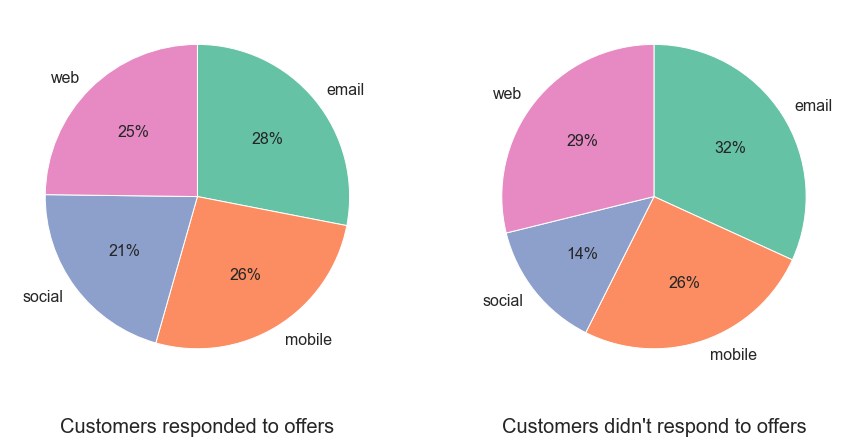

In [43]:
channel_dist_succ = final_df[(final_df['offer_success']==1)][['email','mobile','social','web']].sum()
channel_dist_fail = final_df[(final_df['offer_success']==0)][['email','mobile','social','web']].sum()

plt.figure(figsize = [15,8])
plt.subplot(1,2,1)

channel_dist_succ.plot(kind='pie',colors =base_color,startangle = 90,counterclock=False,autopct='%1.0f%%',textprops={'fontsize': 16})
plt.ylabel('')
plt.xlabel('Customers responded to offers',fontsize=20,labelpad=30);

plt.subplot(1,2,2)
channel_dist_fail.plot(kind='pie',colors=base_color,startangle = 90,counterclock=False,autopct='%1.0f%%',textprops={'fontsize': 16})
plt.ylabel('')
plt.xlabel('Customers didn\'t respond to offers',fontsize=20,labelpad=30);

We can see that customers tend to respond to offers sent via social media where it has the less percentage of customers who did not respond

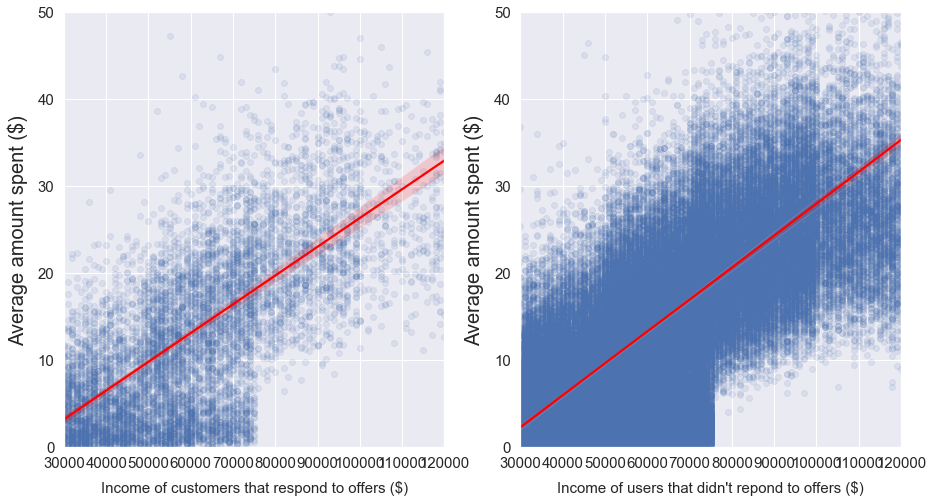

In [44]:
plt.figure(figsize = [15,8])

# Clustered Bar chart
plt.subplot(1,2,1)

sns.regplot(data = final_df[(final_df['anonymous']==0) & (final_df['transaction']==1) & (final_df['offer_success']==1)]\
            ,x='income',y='amount',scatter_kws = {'alpha':1/10},line_kws={'color': 'red'});
plt.ylim([0,50]);
plt.xticks(fontsize=15);
plt.yticks(fontsize=15);

plt.xlabel('Income of customers that respond to offers ($)',fontsize=15,labelpad=10);
plt.ylabel('Average amount spent ($)',fontsize=20,labelpad=10);


# Clustered Bar chart
plt.subplot(1,2,2)

sns.regplot(data = final_df[(final_df['anonymous']==0) & (final_df['transaction']==1) & (final_df['offer_success']==0)]\
            ,x='income',y='amount',scatter_kws = {'alpha':1/10},line_kws={'color': 'red'});
plt.ylim([0,50]);
plt.xticks(fontsize=15);
plt.yticks(fontsize=15);

plt.xlabel('Income of customers that didn\'t repond to offers ($)',fontsize=15,labelpad=10);
plt.ylabel('Average amount spent ($)',fontsize=20,labelpad=10);

There is no diffrence between patterns where diffrent customers tend to spend more according to their income regardless responding to offers or not

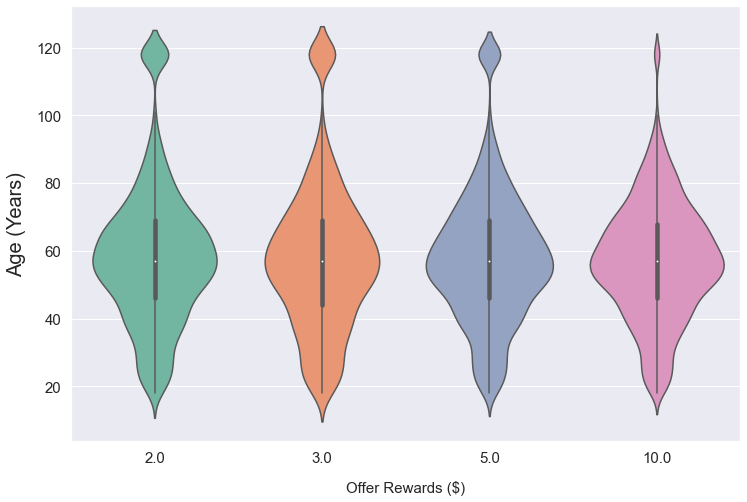

In [45]:
# Plotting
plt.figure(figsize = [12,8])

sns.violinplot(data = final_df[(final_df['offer_success']==1)],palette="Set2",x='offer_reward',y='age');
plt.xticks(fontsize=15)
plt.ylabel('Age (Years)',fontsize=20,labelpad=10);
plt.yticks(fontsize=15);
plt.xlabel('Offer Rewards ($)',fontsize=15,labelpad=15);


Age does'nt play a huge factor in this dataset where customers respond to offer rewards same where you can find the 3$ offers have the least popularity


## Data Modeling

### Predicting User Response

We are now building a Linear support vector classfier from sklearn to predict a customer will respond to an offer or not, we choose the **offer_success** as the output y and features containing customer demographic information.

In [56]:
# Drop unwanted columns
model_df = final_df.drop(['offer_id','user_id','time','offer_received','offer_viewed',\
                          'type_informational','offer_type','gender','email','became_member_on']\
                         ,axis=1)
# Fill Nan values with zeros
model_df[['offer_reward','difficulty','duration','type_bogo','type_discount','mobile','social','web']] =\
model_df[['offer_reward','difficulty','duration','type_bogo','type_discount','mobile','social','web']].fillna(0)

# Fill NaN values in income with mean value
model_df['income'] = model_df['income'].fillna(model_df['income'].mean())

In [57]:
# Select X and y
X = model_df.drop(['offer_success'],axis=1)
y = model_df['offer_success']
# Split
X_train, X_test, Y_train, Y_test = train_test_split(X, y, test_size=0.2)

# We use a pipeline to tune the parameters with grid search
pipeline = Pipeline(
        [
            ("clf", LinearSVC(dual=False)),
        ]
    )
parameters = {"clf__C": [1, 100]}
cv = GridSearchCV(pipeline, param_grid=parameters)

Now we train the model.

In [58]:
cv.fit(X_train, Y_train);

## Model Evaluation

classification report from sklear to evaluate our model

In [59]:
y_pred = cv.predict(X_test)
print(classification_report(Y_test, y_pred, target_names=['Will not respond','Will respond']))

precision    recall  f1-score   support

Will not respond       0.90      0.94      0.92     27873
    Will respond       0.71      0.58      0.64      6554

        accuracy                           0.87     34427
       macro avg       0.81      0.76      0.78     34427
    weighted avg       0.87      0.87      0.87     34427



The report shows that classifing a not reponding to a offer customer is good with 0.92 f1 score while predicting the customers who will respond is not that great with 0.64 f1 score but with model accuracy of 87% which is relativley good.

## Justification

Throughout the notebook we viewed how customer demographics and offer reward has an effect on their response, we identified that
13% of customers do not like to share there personal data and would like to be anonymous.we used this information to exclude them from demographic analysis.

Males customers are about 57% of total customers while females take up 41%. Age distribustion of customers has a mean of 60 years age where most of the users are within that range.but age have a slight effect on user attraction to offer rewards but we noticed that the 3$ offeres are the least attactive offers. As the age increase the amount of money spent in transaction increase.

Most of the customers annual income are bellow 80000\\$ where the majority are in the range between 50000\\$ ans 75000\\$ and fewer users as the income increase.but also as the income increase the amount of money spent in transaction increase.

75% of all the received offers were actually viewed while 71% of them are completed intentionaly, 29% are completed unintentionally.

Transactions related to advertisments have 93% reach and It was also seen that offers has influence on the total transactions or completed offers that occured by 19%, which is pretty big,Social media has a higher rate of viewing offers than any other channel.

Males is attacted to 2,3 and 5 dollar rewards while women tends to go to 10 dollars rewards and on average females spend more than males.

A model to predict a customer response towards an offer based on reward and customer demographic was built with accuracy of 87% and F1-score for those who will respond and those who won't equals to 0.65 & 0.92 respectively

## Conclusion

### Reflection

The process used in this project can be summarized into the following steps:

1. Generate columns for categorical values and filter not used columns.
2. Explore data, analyze customer demographics , events ,offer type distribution and transactions.
3. Identify the cause of each event by comparing it with the time a relevant offer was sent and offer's duration.
4. Visualizing the relationship between customer demographics and user actions whether its responding to events or performing transactions.
5. Modeling and prediction of customer response towards an offer according to his demographic and offer information.  

Recording offers which might be sent to the same user multiple times and identifing each response was the most challenging task.

